# Imports

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container{max-width:80%!important;width:auto!important;}</style>"))

%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [10]:
# uncomment and run the following line if you're having issues with sift: 'cv2.cv2 has no attribute xfeatures2d'
# !pip install opencv-contrib-python==3.4.2.17

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

In [4]:
def show_img(im, ax=None, figsize=(8,8)):
    if not ax: _,ax = plt.subplots(1,1,figsize=figsize)
    if len(im.shape)==2: im = np.tile(im[:,:,None], 3) 
    ax.imshow(im[:,:,::-1]);
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    return ax

# Image feature descriptors

[Image features](https://docs.opencv.org/3.4.9/df/d54/tutorial_py_features_meaning.html) are specific patterns, which are unique, can be easily tracked and compared. Consider the image in Fig.1 below with six candidate features *A* to *F*:
- You can immediately see that *A* and *B* are not very good feautures as it is virtually impossible to find them in the image - they are not unique.
- Features *C* and *D* look a bit better; as they represent the edges of the building they are at least not flat, but it's still difficult to say where exactly to find them in the image.
- Features *E* and *F* are unique!

What about Fig.2? Does any of the boxes represent a good feature?

Fig.1 | Fig.2
    - | - 
![](https://docs.opencv.org/3.4.9/feature_building.jpg) | ![](https://docs.opencv.org/3.4.9/feature_simple.png)

*Feature descriptor* is a way of describing the features in a *robust* and *invariant* way, so you can localise the feature regardless of its location (translation invariance), size (scale invariance), angle (rotation invariance), etc.

## Corner detection

We have already established that corners seem to be good features. Corners can be thought of as image regions with large variation in intensity in all directions. OpenCV offers two corner detection algorithms: [Harris Corner Detection](https://docs.opencv.org/3.4.9/dc/d0d/tutorial_py_features_harris.html) and [Shi-Tomasi Corner Detection](https://docs.opencv.org/3.4.9/d4/d8c/tutorial_py_shi_tomasi.html) (the paper can be found [here](http://www.ai.mit.edu/courses/6.891/handouts/shi94good.pdf)).

### Harris Corner Detection

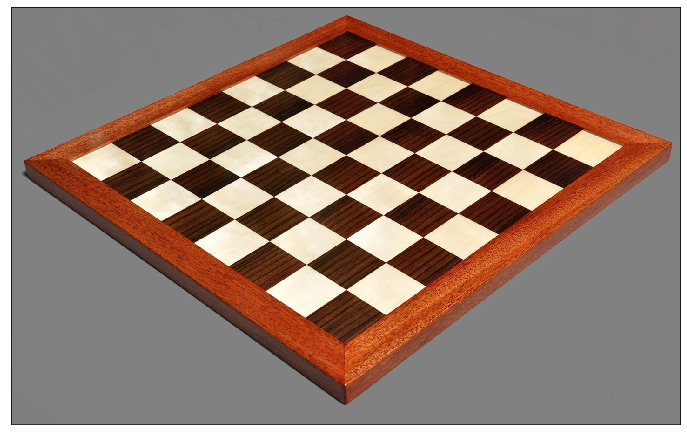

In [5]:
im = cv2.imread('05-files/chessboard.jpg')
show_img(im, figsize=(12,12));

In [6]:
gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY).astype(np.float32)

In [7]:
??cv2.cornerHarris

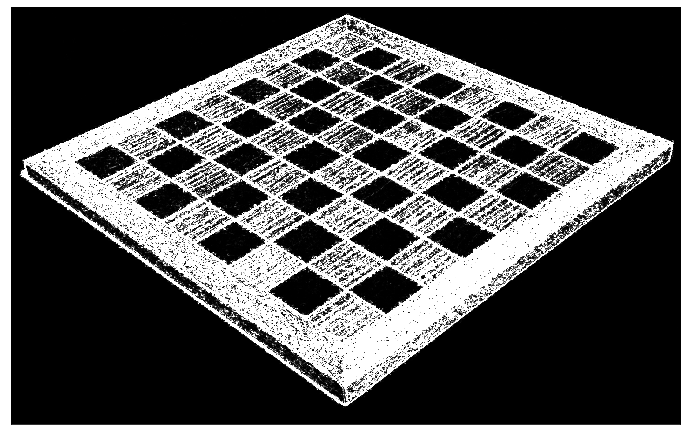

In [8]:
dst = cv2.cornerHarris(gray, 2, 3, 0.04)
show_img(cv2.convertScaleAbs(dst), figsize=(12,12));

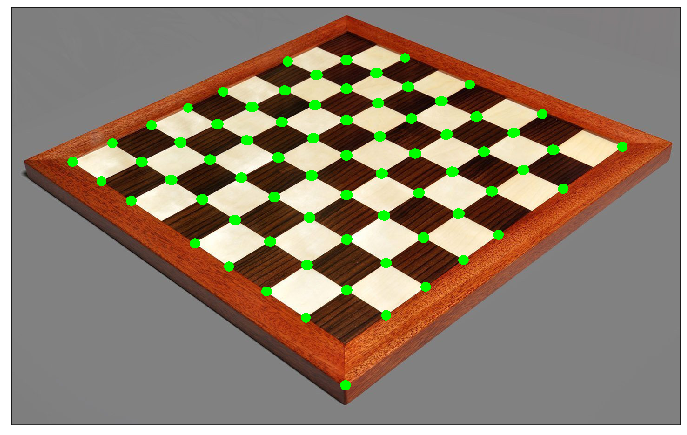

In [13]:
im_copy = im.copy()
for pt in np.argwhere(dst>0.05*dst.max()):
    im_copy = cv2.circle(im_copy, tuple(pt[::-1]), 5, (0,255,0), 10)
show_img(im_copy, figsize=(12,12));

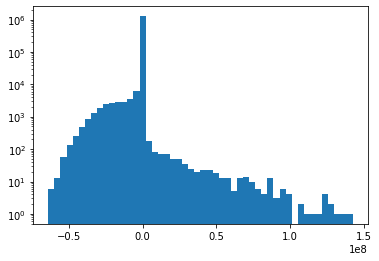

In [15]:
plt.hist(dst.flatten(), 50, log=True);

### Shi-Tomasi Corner Detection

This is a small modification to Harris detection, with claims* that it performs better.

\* some 95% of scientific progress is *incremental*, new algorithms address certain weaknesses of the old ones, but at the same time can introduce new weaknesses that the original algorithm didn't have!

In [16]:
??cv2.goodFeaturesToTrack

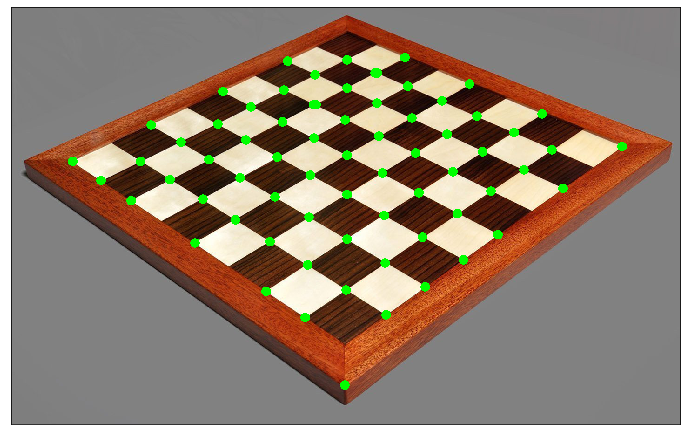

In [19]:
im_copy = im.copy()
corners = cv2.goodFeaturesToTrack(gray, 70, 0.01, 5, useHarrisDetector=False)
for c in corners:
    im_copy = cv2.circle(im_copy, tuple(c.squeeze()), 5, (0,255,0), 10)
show_img(im_copy, figsize=(12,12));

## SIFT and SURF

[SIFT](https://docs.opencv.org/3.4.9/da/df5/tutorial_py_sift_intro.html) (Scale-Invariant Feature Transform) and [SURF](https://docs.opencv.org/3.4.9/df/dd2/tutorial_py_surf_intro.html) (Speeded-Up Robust Features) are two popular descriptor types applicable to many problems. Thei biggest limitation is that they are **patented**, so they are not free to use commercially.

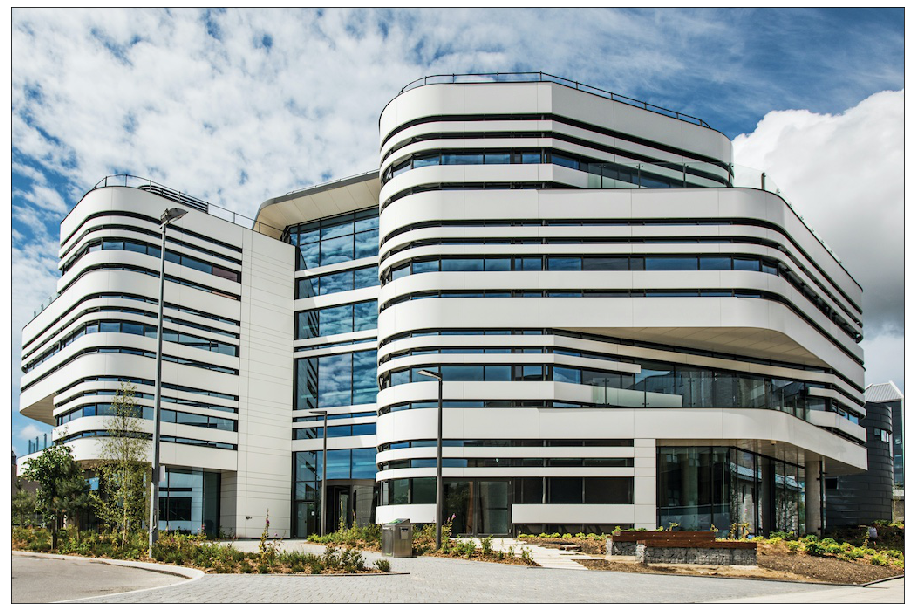

In [20]:
im = cv2.imread('05-files/fusion-building.jpg')
show_img(im, figsize=(16,16));

In [21]:
sift = cv2.xfeatures2d.SIFT_create()
kp, des = sift.detectAndCompute(im, None)

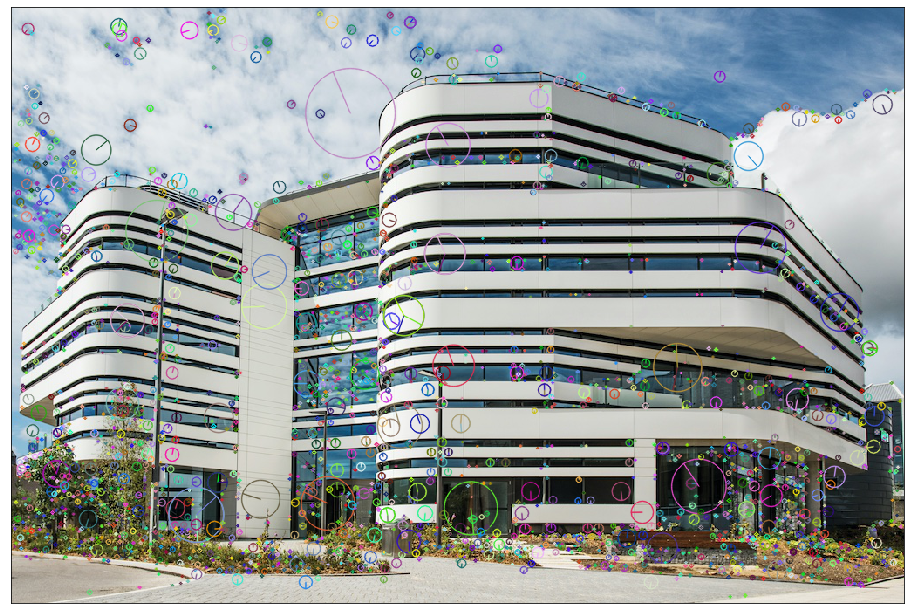

In [25]:
im_copy = im.copy()
cv2.drawKeypoints(im, kp, im_copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(im_copy, figsize=(16,16));

In [26]:
des.shape

(3322, 128)

In [29]:
surf = cv2.xfeatures2d.SURF_create(1329, extended=False)
kp, des = surf.detectAndCompute(im, None)
des.shape

(3322, 64)

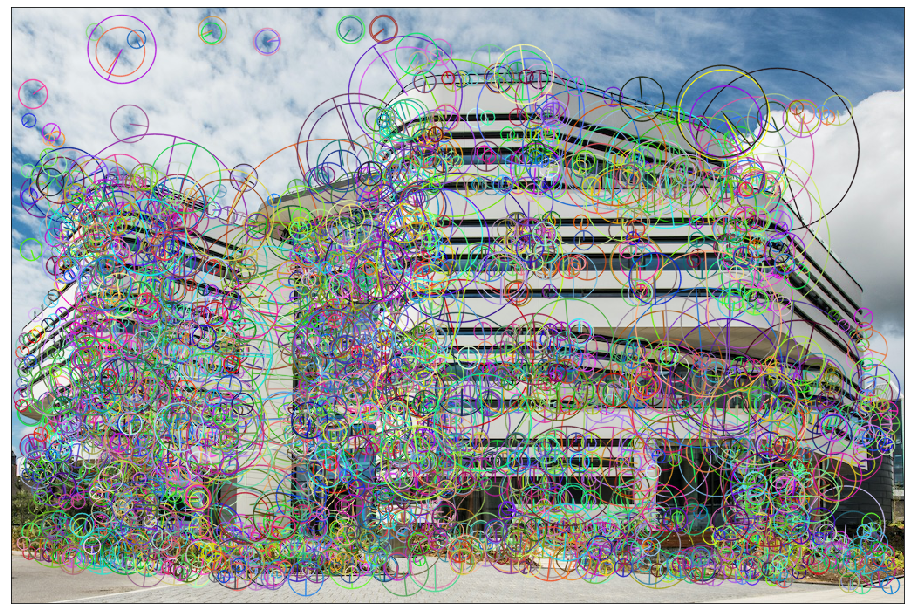

In [30]:
im_copy = im.copy()
cv2.drawKeypoints(im, kp, im_copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(im_copy, figsize=(16,16));

Let's see how fast SURF is!

In [31]:
sift = cv2.xfeatures2d.SIFT_create()
surf = cv2.xfeatures2d.SURF_create(1329, upright=False, extended=True)

In [32]:
%timeit -n10 sift.detectAndCompute(im, None)

248 ms ± 15.3 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [38]:
%timeit -n10 surf.detectAndCompute(im, None)

532 ms ± 186 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


## FAST + BRIEF = ORB

- [FAST](https://docs.opencv.org/3.4.9/df/d0c/tutorial_py_fast.html) (Features from Accelerated Segment Test) is a *corner/keypoint detection* algorithm which is both **fast** (hence the name, important for embedded devices like robotic vacuum cleaners) and **free** (not patented).
- [BRIEF](https://docs.opencv.org/3.4.9/dc/d7d/tutorial_py_brief.html) (Binary Robust Independent Elementary Features) is a *descriptor* calculation algorithm which is much more memory efficient than SIFT and SURF (again, important for embedded devices) and also free.
- [ORB](https://docs.opencv.org/3.4.9/d1/d89/tutorial_py_orb.html) (Oriented FAST and Rotated BRIEF) as a combination of these two with some additional goodies! So fast, small and free!

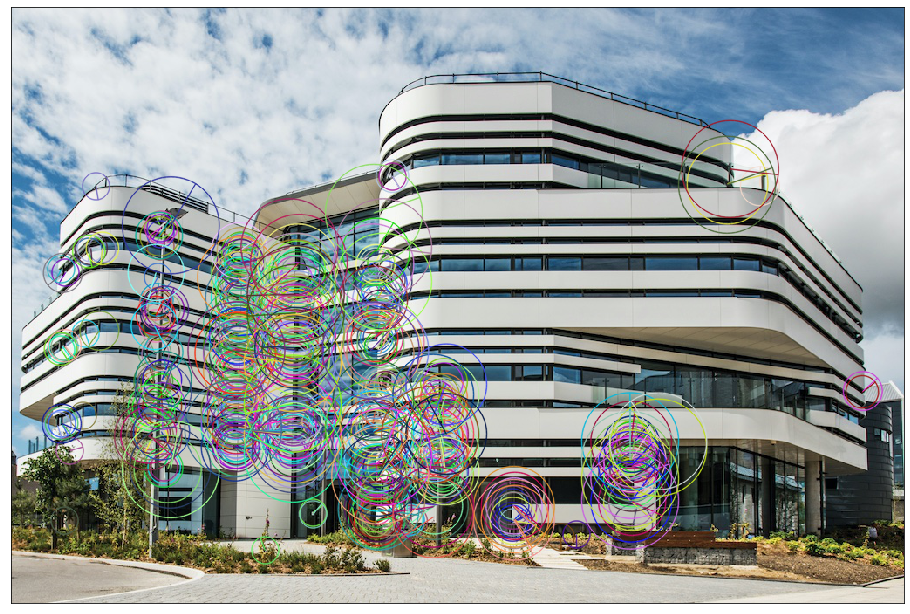

In [35]:
im = cv2.imread('05-files/fusion-building.jpg')
orb = cv2.ORB_create()
kp = orb.detect(im, None)
kp, des = orb.compute(im, kp)
img2 = cv2.drawKeypoints(im, kp, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
show_img(img2, figsize=(16,16));

In [36]:
des.shape

(500, 32)

In [37]:
orb = cv2.ORB_create()
%timeit -n10 orb.compute(im, orb.detect(im, None))

30.5 ms ± 2.41 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


# Feature matching

Having detected and described a set of features in multiple images, we now want to match them, i.e. work out which features in the first image correspond with features in the second image. Feature matching can then facilitate other tasks like panorama stitching or object detection. 

In [39]:
def show_imgs(ims, rows=1, figsize=(16,8)):
    _,ax = plt.subplots(rows, len(ims)//rows, figsize=figsize)
    [show_img(im,ax_) for im,ax_ in zip(ims,ax.flatten())]
    return ax

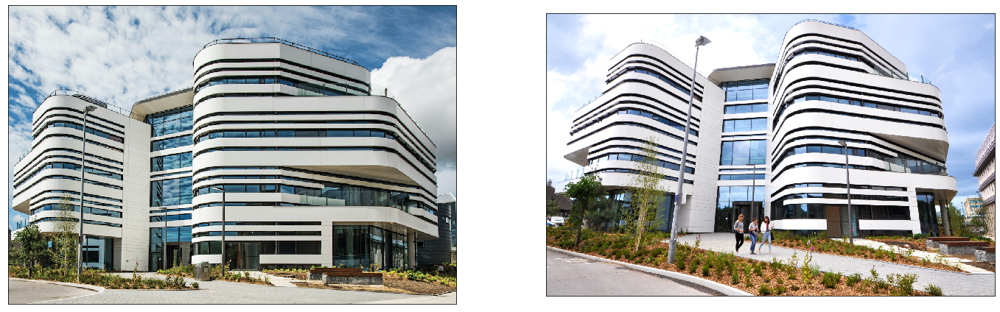

In [40]:
im1 = cv2.imread('05-files/fusion-building.jpg')
im2 = cv2.imread('05-files/fusion-building2.jpg')
show_imgs((im1,im2), rows=1, figsize=(24,12));

## Brute-force matcher

The [brute-force matcher](https://docs.opencv.org/3.4.9/dc/dc3/tutorial_py_matcher.html) tries to match each and every feature in the first image with each and every features in the second image, which is slow. If the first image has $n_1$ features and the second image has $n_2$ features, the brute-force approach will evaluate $n_1 \times n_2$ potential matches.

In [42]:
descr = cv2.xfeatures2d.SURF_create()
# descr = cv2.ORB_create()
kp1,des1 = descr.detectAndCompute(im1,None)
kp2,des2 = descr.detectAndCompute(im2,None)

`cv2.BFMatcher` takes two arguments:
- `normType` - denotes *how* to calculate the similarity of the descriptors; `cv2.NORM_L2` (i.e. Euclidean) is the default, which works well for SIFT and SURF; for ORB `cv2.NORM_HAMMING` (i.e. bit distance)
- `crossCheck` - `False` by default; if `True` only returns matches which are "symmetrical", i.e. where a pair of descriptors are each others best matches

The `cv2.BFMatcher.match(queryDescr, trainDescr)` method returns a `list` of `DMatch` objects:
- `DMatch.distance` - distance between descriptors using `normType`
- `DMatch.queryIdx` - index of the descriptor in query descriptors
- `DMatch.trainIdx` - index of the descriptor in train descriptors

In [43]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key=lambda x: x.distance)

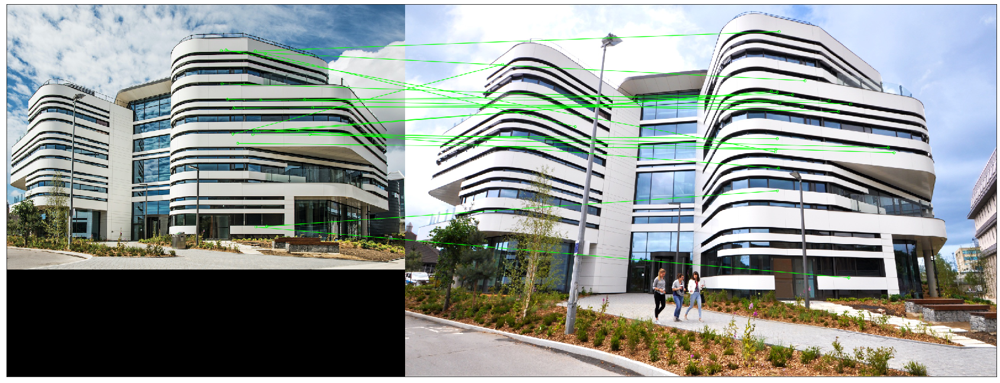

In [50]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:5],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,matchColor=(0,255,0))
show_img(im_match, figsize=(30,30));

## FLANN (Fast Library for Approximate Nearest Neighbors) matching

In [47]:
FLANN_INDEX_KDTREE=1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params,search_params)

matches = flann.match(des1,des2)
matches = sorted(matches, key=lambda x: x.distance)

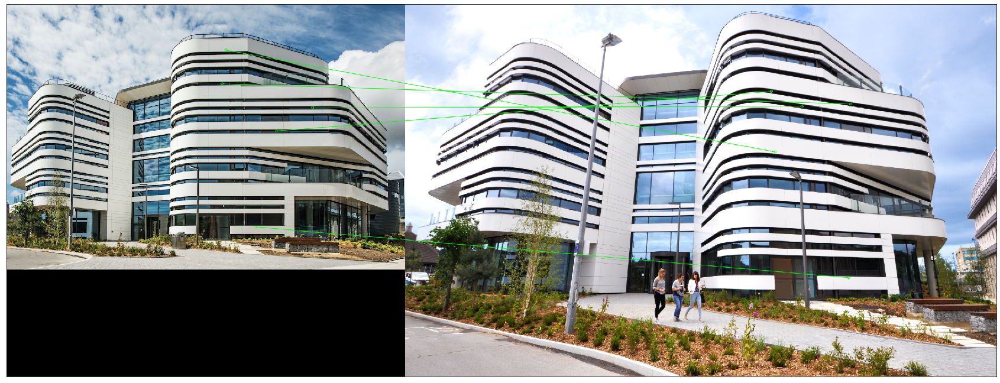

In [48]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:5],None,matchColor=(0,255,0),flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
show_img(im_match, figsize=(30,30));

## Homography

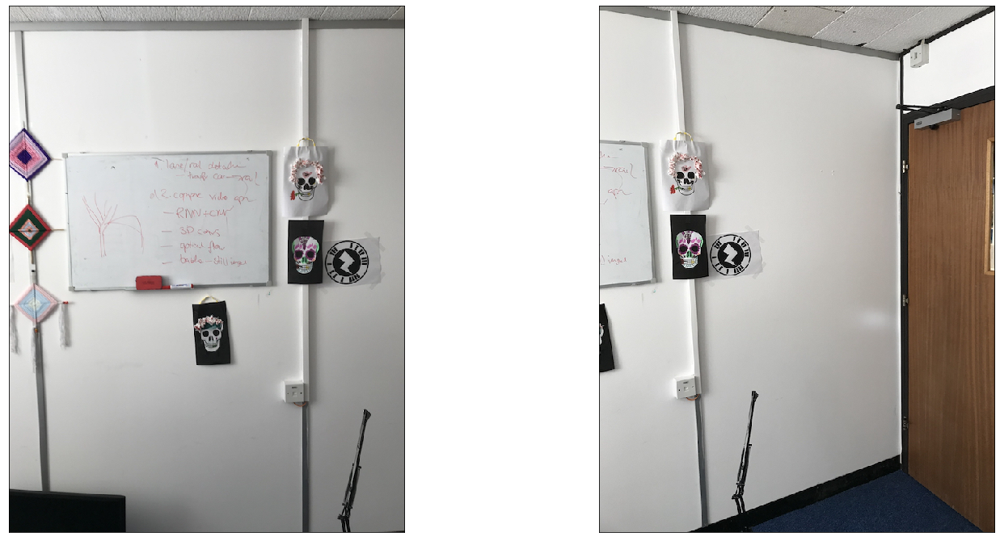

In [51]:
im1 = cv2.imread('05-files/pano-L.jpg')
im2 = cv2.imread('05-files/pano-R.jpg')
show_imgs((im1,im2), rows=1, figsize=(24,12));

In [52]:
descr = cv2.ORB_create()
kp1,des1 = descr.detectAndCompute(im1, None)
kp2,des2 = descr.detectAndCompute(im2, None)

In [53]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bf.match(des1,des2)
matches = sorted(matches, key=lambda x: x.distance)

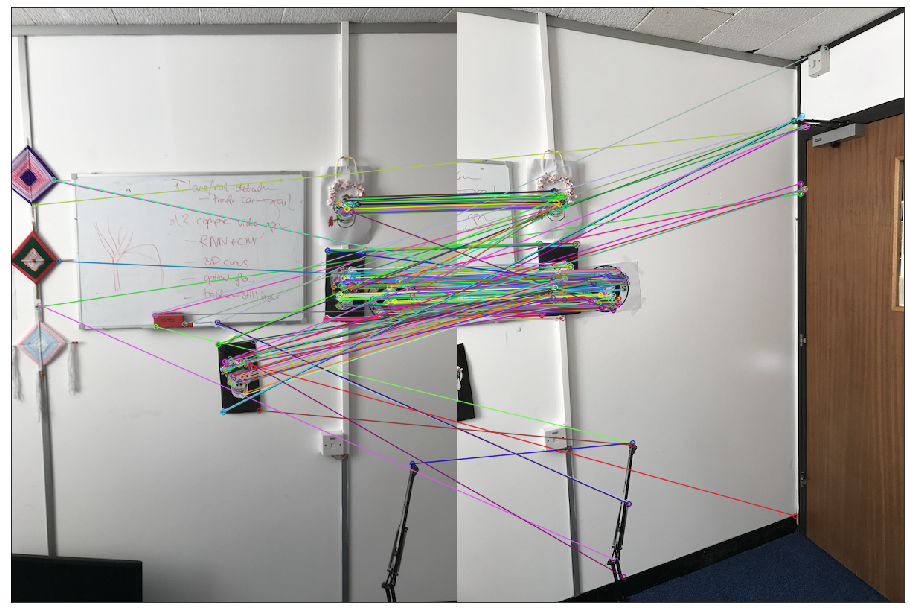

In [55]:
im_match = cv2.drawMatches(im1,kp1,im2,kp2,matches[:50],None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
show_img(im_match, figsize=(16,16));

We will use the [RANSAC (Random Sample Consensus)](https://en.wikipedia.org/wiki/Random_sample_consensus) algorithm to find the transformation matrix based on true matches and ignoring the incorrect ones.

In [56]:
pts1 = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1,1,2)
pts2 = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1,1,2)
M, mask = cv2.findHomography(pts2, pts1, cv2.RANSAC, 5.0) # RANSAC = Random Sample Consensus

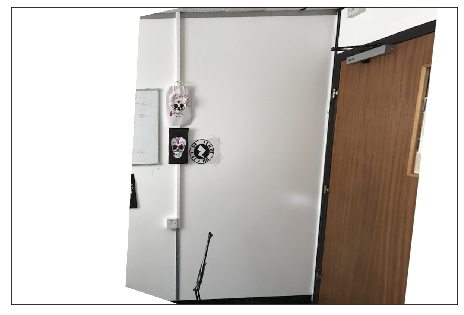

In [57]:
out = cv2.warpPerspective(im2, M, (im1.shape[1]+im2.shape[1], im1.shape[0]), borderValue=(255,255,255))
show_img(out);

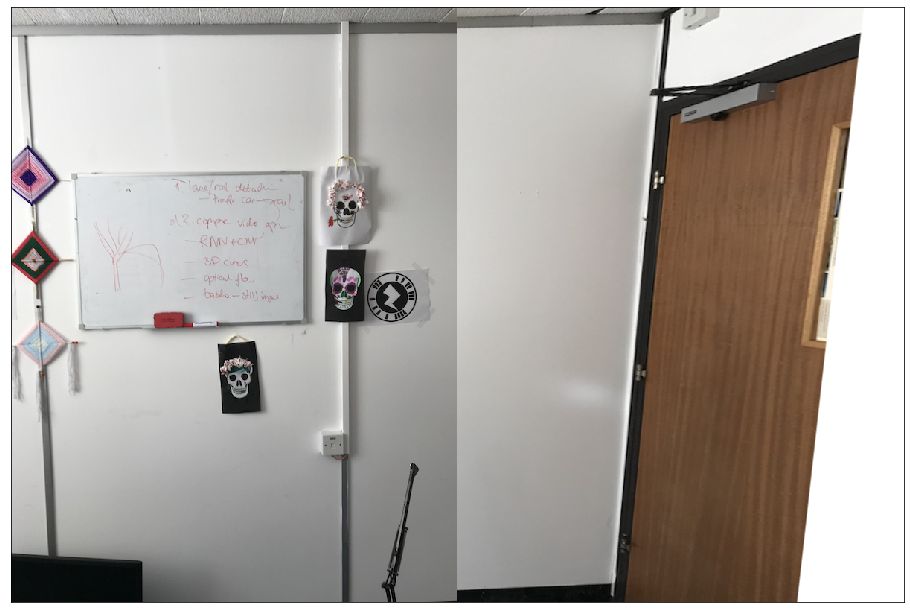

In [60]:
alpha = 0.4
blended = out
blended[0:im1.shape[0], 0:im1.shape[1]] = (1-alpha)*out[0:im1.shape[0], 0:im1.shape[1]] + alpha*im1
show_img(blended.astype(np.uint8), figsize=(16,16));

## Panorama stitching in one line of code

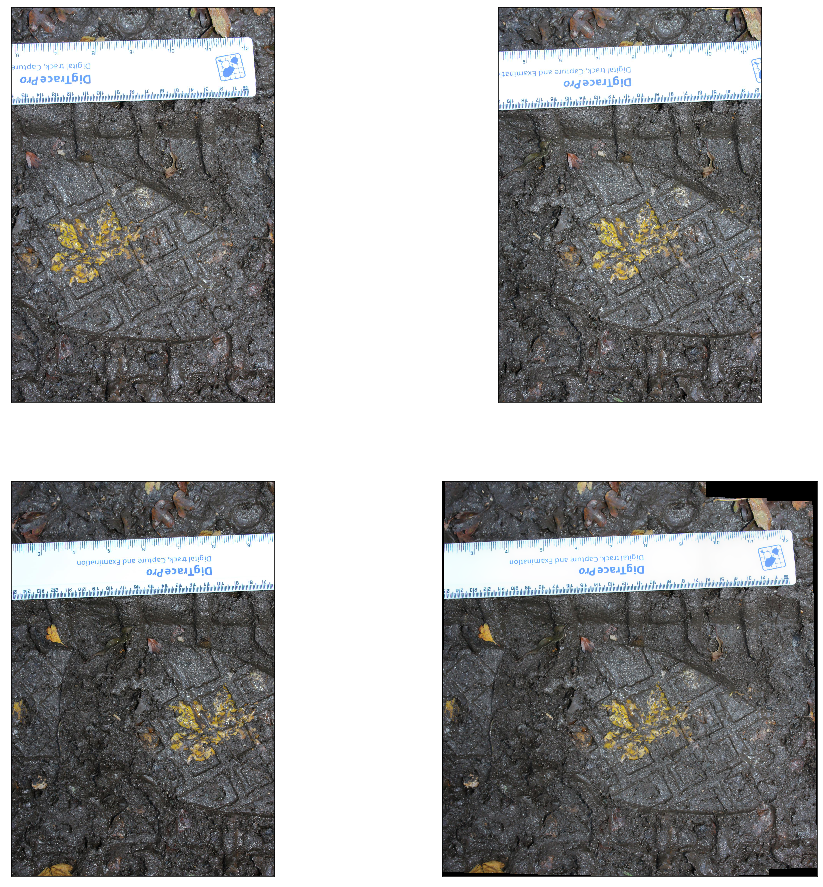

In [61]:
stitcher = cv2.createStitcher(False)
im1 = cv2.imread('05-files/IMG_5781.JPG')
im2 = cv2.imread('05-files/IMG_5782.JPG')
im3 = cv2.imread('05-files/IMG_5783.JPG')
result = stitcher.stitch((im1, im2, im3))

show_imgs((im1,im2,im3, result[1]), rows=2, figsize=(16,16));

# Optical flow

[Optical flow](https://en.wikipedia.org/wiki/Optical_flow) is the pattern of apparent motion of objects between two consecutive frames of a video sequence caused by the movemement of object or camera. The ball in the image below moves in 5 consecutive frames with the arrow denoting the displacement vector.
![](https://upload.wikimedia.org/wikipedia/en/1/10/Optical_flow_example_v2.png)

## Working with videos

In [ ]:
# !pip install ffmpeg

In [68]:
cap = cv2.VideoCapture('05-files/dashcam.mov')

frames = []
for i in range(100):
    ret,frame = cap.read()
    frames.append(frame.transpose(1,0,2)[:,::-1])
    
cap.release()

In [69]:
import matplotlib.animation as animation

def get_video(frames, interval=50, figsize=(12,8)):
    
    def animate(i):
        img.set_data(frames[i])
        return (img,)

    fig, ax = plt.subplots(1,1,figsize=figsize)
    img = ax.imshow(frames[0])
    ax.axis('off')
    anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=interval, blit=True, repeat_delay=5000)
    plt.close()
    return anim.to_html5_video()

In [70]:
HTML(get_video(frames))

## Sparse optical flow (Lucas-Kanade)

In [71]:
fix_frame = lambda fr: fr.transpose(1,0,2)[:,::-1,:]

color = np.random.randint(0,255,(100,3))

cap = cv2.VideoCapture('05-files/dashcam.mov')
ret, old_frame = cap.read()
old_gray = cv2.cvtColor(old_frame, cv2.COLOR_BGR2GRAY)
p0 = cv2.goodFeaturesToTrack(old_gray, mask=None, maxCorners=100, qualityLevel=0.3, minDistance=7, blockSize=7)

mask = np.zeros_like(old_frame) # for drawing
frames = []
for i in range(100):
    ret,frame = cap.read()
    if not ret: break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    p1,st,_ = cv2.calcOpticalFlowPyrLK(old_gray, gray, p0, None, winSize=(15,15), maxLevel=2, criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

    good_new, good_old = p1[st==1], p0[st==1]

    # draw the tracks
    for i,(new,old) in enumerate(zip(good_new,good_old)):
        a,b = new.ravel()
        c,d = old.ravel()
        mask = cv2.line(mask, (a,b),(c,d), color[i].tolist(), 2)
        frame = cv2.circle(frame,(a,b),5,color[i].tolist(),-1)
    img = cv2.add(frame,mask)
    frames.append(fix_frame(img))

    old_gray = gray.copy()
    p0 = good_new.reshape(-1,1,2)
    
cap.release()

In [72]:
HTML(get_video(frames, interval=200))

## Dense optical flow

Documentation of `cv2.calcOpticalFlowFarneback` can be found [here](https://docs.opencv.org/3.0-beta/modules/video/doc/motion_analysis_and_object_tracking.html#calcopticalflowfarneback).

In [73]:
cap = cv2.VideoCapture('05-files/people.avi')

ret, frame1 = cap.read()
prv = cv2.cvtColor(frame1,cv2.COLOR_BGR2GRAY)
hsv = np.zeros_like(frame1)
hsv[...,1] = 255

frames = []
for i in range(100):
    ret, frame2 = cap.read()
    nxt = cv2.cvtColor(frame2,cv2.COLOR_BGR2GRAY)
    flow = cv2.calcOpticalFlowFarneback(prv,nxt,None,pyr_scale=0.5,levels=3,winsize=15,iterations=3,poly_n=5,poly_sigma=1.2,flags=0)    
    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])
    hsv[...,0] = ang*180/np.pi/2
    hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2BGR)
    prv = nxt
    frames.append(np.hstack((frame2, rgb)))

cap.release()

In [74]:
HTML(get_video(frames, interval=50))

One interesting application of optical flow is liveness detection - see Section 2.4 of [this](https://arxiv.org/pdf/1405.2227.pdf) paper! Robust liveness detection from photographs and videos is a decent project idea! 

# Homework

## For all

Modify this notebook to allow for panorama stitching of 3 and more images. You should make it work on your own images, and you're not allowed to use the `cv2.createStitcher()` method.


## For volunteers

Prepare a notebook comparing SIFT, SURF and ORB algorithms in the context of descriptor matching. You have already seen that each of these approaches tends to identify different keypoints. Is any of them better than the others for a particular type of image (e.g. outdoor scenes)? Try mixing them up too - for example, what would happen if you used SIFT keypoints with SURF or ORB descriptors?